### <center> MACHINE LEARNING CLASSIFICATION MODEL - CREDIT SCORE BRACKET (MULTICLASS)</center>

### Introduction

The objective of this project is to explore the data to identify the pattern that causes
the person to have a good or bad or standard type credit score and build a machine
learning model that should be able to predict or classify the credit score type.

<b>Importing required Libraries</b>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from warnings import filterwarnings
filterwarnings('ignore')

<b>Read the train and test data sets, and check for the datatypes.</b>

In [80]:
train_df = pd.read_csv('train.csv')
test_df = pd.read_csv('test.csv')
final = pd.concat([train_df,test_df],ignore_index=True,sort=False)
pd.set_option('display.max_columns', None)
final.head(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,11.27,4.0,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",-1,NaN,11.27,4.0,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,_,4.0,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",5,4,6.27,4.0,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",6,NaN,11.27,4.0,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


In [81]:
final.shape

(150000, 28)

### Cleaning

### Occupation

In [82]:
final['Occupation'].value_counts()

_______          10500
Lawyer            9899
Engineer          9562
Architect         9550
Mechanic          9459
Accountant        9404
Scientist         9403
Developer         9381
Media_Manager     9362
Teacher           9318
Entrepreneur      9277
Journalist        9122
Doctor            9114
Manager           8973
Musician          8858
Writer            8818
Name: Occupation, dtype: int64

In [83]:
# imputing Occupation with Customer ID using mode 
qual_ind = final[final['Occupation'] == '_______'].Customer_ID.unique()
def modeimp(i):
    try:
        return final.Occupation[final.Customer_ID==i].mode()[0]
    except: 
        return np.nan

In [84]:
for i in qual_ind:
    final['Occupation'] = np.where((final.Customer_ID == i) & (final['Occupation'] == '_______'),modeimp(i),final.Occupation)

In [85]:
final['Occupation'].value_counts()

Lawyer           10644
Engineer         10296
Architect        10236
Mechanic         10164
Scientist        10116
Accountant       10116
Developer        10080
Media_Manager    10080
Teacher          10008
Entrepreneur      9972
Doctor            9852
Journalist        9804
Manager           9648
Musician          9528
Writer            9456
Name: Occupation, dtype: int64

### SSN

In [86]:
final['SSN'].value_counts()

#F%$D@*&8      8400
078-73-5990      12
047-16-1543      12
255-39-8777      12
159-51-7992      12
               ... 
414-76-9835       7
695-71-7676       7
803-44-6289       7
074-52-8105       7
642-73-7670       6
Name: SSN, Length: 12501, dtype: int64

In [87]:
# imputing SSN with Customer ID using mode 
qual_ind1 = final[final['SSN'] == '#F%$D@*&8'].Customer_ID.unique()
def modeimp(i):
    try:
        return final.SSN[final.Customer_ID==i].mode()[0]
    except: 
        return np.nan

In [88]:
for i in qual_ind1:
    final['SSN'] = np.where((final.Customer_ID == i) & (final['SSN'] == '#F%$D@*&8'),modeimp(i),final.SSN)

In [89]:
final['SSN'].value_counts()

821-00-0265    12
544-05-0223    12
381-36-5261    12
994-73-1178    12
647-44-9598    12
               ..
952-71-6906    12
183-30-3638    12
549-17-7822    12
642-73-7670     6
#F%$D@*&8       6
Name: SSN, Length: 12501, dtype: int64

### Payment_Behaviour

In [90]:
final['Payment_Behaviour'].value_counts()

Low_spent_Small_value_payments      38207
High_spent_Medium_value_payments    26462
Low_spent_Medium_value_payments     20698
High_spent_Large_value_payments     20565
High_spent_Small_value_payments     16991
Low_spent_Large_value_payments      15677
!@9#%8                              11400
Name: Payment_Behaviour, dtype: int64

In [91]:
# imputing Payment_Behaviour with Customer ID using mode 
qual_ind2 = final[final['Payment_Behaviour'] == '!@9#%8'].Customer_ID.unique()
def modeimp(i):
    try:
        return final.Payment_Behaviour[(final.Customer_ID==i) & (final.Payment_Behaviour!='!@9#%8')].mode()[0]
    except: 
        return np.nan

In [92]:
for i in qual_ind2:
    final['Payment_Behaviour'] = np.where((final.Customer_ID == i) & (final['Payment_Behaviour'] == '!@9#%8'),modeimp(i),final.Payment_Behaviour)

In [93]:
final['Payment_Behaviour'].value_counts()

Low_spent_Small_value_payments      42046
High_spent_Medium_value_payments    29292
High_spent_Large_value_payments     22952
Low_spent_Medium_value_payments     21676
High_spent_Small_value_payments     17764
Low_spent_Large_value_payments      16270
Name: Payment_Behaviour, dtype: int64

### Age

In [94]:
# replacing "_" and dtype  conversion
final["Age"] = final["Age"].str.replace('_', '')
final["Age"] = final["Age"].astype(int)

In [95]:
# imputing age with Customer Id using median
qual_ind3 = final[(final['Age']>85) | (final['Age']<0)].Customer_ID.unique()
def agemedimp(i):
    try:
        return final.Age[final.Customer_ID==i].median()
    except: 
        return np.nan

In [96]:
for i in qual_ind3:
    final['Age'] = np.where(((final.Customer_ID == i) & ((final['Age'] > 85) | (final['Age']<0))),agemedimp(i),final.Age)

In [97]:
# imputing null values in Age with with Customer ID using Mode 
qual_ind5 = final[final['Age'].isnull()].Customer_ID.unique()
def modimp(i):
    try:
        return final.Age[final.Customer_ID==i].mode()[0]
    except: 
        return np.nan

In [98]:
for i in qual_ind5:
    final['Age'] = np.where((final.Customer_ID == i) & (final['Age'].isna()),modimp(i),final.Age)

### Name

In [99]:
# imputing null values in name with with Customer ID using Mode 
qual_ind4 = final[final['Name'].isnull()].Customer_ID.unique()
def modimp(i):
    try:
        return final.Name[final.Customer_ID==i].mode()[0]
    except: 
        return np.nan

In [100]:
for i in qual_ind4:
    final['Name'] = np.where((final.Customer_ID == i) & (final['Name'].isna()),modimp(i),final.Name)

In [101]:
# Correcting few anomalies 
final['Age'] = final['Age'].replace('_', '')
final['Annual_Income'] = final['Annual_Income'].replace('_', '')
final['Num_of_Loan'] = final['Num_of_Loan'].replace('_', '')
final["Changed_Credit_Limit"] = final["Changed_Credit_Limit"].replace('_', '')
final["Num_of_Delayed_Payment"] = final["Num_of_Delayed_Payment"].replace('_', '')

<b># Step 6: Convert the Credit_History_Age datatype variable into float data types by taking 
only year and month. Example. 22 years and 1 month → 22.1. And the 
Payment_of_Min_Amount column you might find some other weird values apart from Yes 
and No. And If you have combined the train and test datasets, then change the month's 
names into its number.</b>

### credit history age

In [102]:
final['Credit_History_Age']

0          22 Years and 1 Months
1                            NaN
2          22 Years and 3 Months
3          22 Years and 4 Months
4          22 Years and 5 Months
                   ...          
149995                       NaN
149996    31 Years and 11 Months
149997     32 Years and 0 Months
149998     32 Years and 1 Months
149999     32 Years and 2 Months
Name: Credit_History_Age, Length: 150000, dtype: object

In [103]:
# Convert the Credit_History_Age datatype variable into float data types by taking only year and month. Example. 22 years and 1 month
final1 = final.copy()
final1['Credit_History_Age_Years'] = final['Credit_History_Age'].str.split(' ').str[0]
final1['Credit_History_Age_Months'] = final['Credit_History_Age'].str.split(' ').str[3]


final1['Credit_History_Age_Years'] = final1['Credit_History_Age_Years'].astype(float)
final1['Credit_History_Age_Months']= final1['Credit_History_Age_Months'].astype(float)

final['Credit_History_Age'] = (final1['Credit_History_Age_Years']) + round((final1['Credit_History_Age_Months']/12),1)

### Payment of minimum amount

In [104]:
final.Payment_of_Min_Amount=np.where(final.Payment_of_Min_Amount=='NM','No',final.Payment_of_Min_Amount)

In [105]:
final.Payment_of_Min_Amount.value_counts()

Yes    78484
No     71516
Name: Payment_of_Min_Amount, dtype: int64

### Month

In [106]:
# change the month's names into its number.
month_name_to_number = {
    'January': 1,
    'February': 2,
    'March': 3,
    'April': 4,
    'May': 5,
    'June': 6,
    'July': 7,
    'August': 8,
    'September': 9,
    'October': 10,
    'November': 11,
    'December': 12
}

final['Month'] = final['Month'].map(month_name_to_number)

In [107]:
final['Month'].value_counts()

1     12500
2     12500
3     12500
4     12500
5     12500
6     12500
7     12500
8     12500
9     12500
10    12500
11    12500
12    12500
Name: Month, dtype: int64

<b>Step 7: Find out the missing values in the data frame and handle them in the best way 
possible. One way of solving this is by imputing the missing values with a customer-wise 
median.</b>

In [108]:
final[final.Age>100].Age.value_counts()

Series([], Name: Age, dtype: int64)

In [109]:
#name
#month
#age
#occupation
#credit history
#SSN
#payment behaviour
#payment of minimum amount

In [110]:
final.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')

In [111]:
#for testing
# def convert(x):
#     try:
#         return float(x)
#     except:
#         return x
    
# inc = final.Annual_Income.map(convert)

In [112]:
# inc[inc.map(lambda x: type(x))==str].value_counts()

### Annual Income

In [113]:
final['Annual_Income']=final.Annual_Income.str.replace('_','').astype('float')

In [114]:
final['Annual_Income']=round(final['Annual_Income'])

### Monthly inhand salary

In [115]:
#filling the salaries with previous/next month of the same customer
mis_null= final[(final['Monthly_Inhand_Salary'].isna())].Customer_ID.unique()

for i in mis_null:
    final.iloc[final[final['Customer_ID']==i].index,8] = final[final['Customer_ID']==i].Monthly_Inhand_Salary.fillna(method='bfill')
    final.iloc[final[final['Customer_ID']==i].index,8] = final[final['Customer_ID']==i].Monthly_Inhand_Salary.fillna(method='ffill')

### number of bank accounts

In [116]:
# imputing wrong number of bank accounts with median
wrong_bank_accounts = final[final.Num_Bank_Accounts>11].Customer_ID.unique()
for i in wrong_bank_accounts:
    final['Num_Bank_Accounts'] = np.where((final.Customer_ID == i) & (final.Num_Bank_Accounts>11),final.Num_Bank_Accounts[final.Customer_ID==i].median(),final.Num_Bank_Accounts)

### number of credit card

In [117]:
# imputing wrong number of credit cards with median
wrong_credit_cards = final[final.Num_Credit_Card>11].Customer_ID.unique()
for i in wrong_credit_cards:
    final['Num_Credit_Card'] = np.where((final.Customer_ID == i) & (final.Num_Credit_Card>11),final.Num_Credit_Card[final.Customer_ID==i].median(),final.Num_Credit_Card)

### interest_rate

In [118]:
# imputing wrong interest rate with median
wrong_IR = final[final.Interest_Rate>35].Customer_ID.unique()
for i in wrong_IR:
    final['Interest_Rate'] = np.where((final.Customer_ID == i) & (final.Interest_Rate>35),final.Interest_Rate[final.Customer_ID==i].median(),final.Interest_Rate)

### number of loans

In [119]:
final['Num_of_Loan'] =final.Num_of_Loan.str.replace('_','').astype(int)

In [120]:
# imputing wrong number of loans with median
wrong_loans = final[(final.Num_of_Loan>10) | (final.Num_of_Loan<=0)].Customer_ID.unique()
for i in wrong_loans:
    final['Num_of_Loan'] = np.where((final.Customer_ID == i) & ((final.Num_of_Loan>10)| (final.Num_of_Loan<=0)),final.Num_of_Loan[final.Customer_ID==i].median(),final.Num_of_Loan)

In [121]:
final['Num_of_Loan'].value_counts()

3.0    23628
2.0    23568
4.0    23184
0.0    17112
1.0    16692
6.0    12216
7.0    11520
5.0    11292
9.0     5784
8.0     5004
Name: Num_of_Loan, dtype: int64

### number of delayed payment

In [123]:
final['Num_of_Delayed_Payment'] = final.Num_of_Delayed_Payment.str.replace('_','').astype('float')

In [124]:
# imputing wrong Delayed payments with median
wrong_DP = final[(final.Num_of_Delayed_Payment>29) | (final.Num_of_Delayed_Payment<0) |  (final.Num_of_Delayed_Payment.isna())].Customer_ID.unique()
for i in wrong_DP:
    final['Num_of_Delayed_Payment'] = np.where((final.Customer_ID == i) & ((final.Num_of_Delayed_Payment>29) | (final.Num_of_Delayed_Payment<0) |  (final.Num_of_Delayed_Payment.isna())),final.Num_of_Delayed_Payment[final.Customer_ID==i].median(),final.Num_of_Delayed_Payment)

In [125]:
#num_of_delayed payments - fill with mode - null,negatives and >29
#Changed_Credit_Limit - fill with mode - null
#Num_Credit_Inquiries - fill with mode > 10
#Credit_Mix - _ - fill with mode
#Credit_History_Age - interpolate customerid wise
#Total_EMI_per_month - fill with mode > 1000
#Amount_invested_monthly - fill with median __10000__
# Monthly balance - __-333333333333333333333333333__ with median

### Changed_Credit_Limit

In [212]:
# imputing wrong Changed_Credit_Limit with mode
wrong_CCL = final[(final.Changed_Credit_Limit.isna())].Customer_ID.unique()
for i in wrong_CCL:
    final['Changed_Credit_Limit'] = np.where((final.Customer_ID == i) & (final.Changed_Credit_Limit.isna()),final.Changed_Credit_Limit[final.Customer_ID==i].median(),final.Changed_Credit_Limit)

### Num_Credit_Inquiries

In [27]:
# imputing wrong Num_Credit_Inquiries with mode
wrong_CI = final[(final.Num_Credit_Inquiries>10) | (final.Num_Credit_Inquiries.isna())].Customer_ID.unique()
for i in wrong_CI:
    final['Num_Credit_Inquiries'] = np.where(((final.Customer_ID == i) & ((final.Num_Credit_Inquiries>10) | (final.Num_Credit_Inquiries.isna()))),final.Num_Credit_Inquiries[final.Customer_ID==i].mode()[0],final.Num_Credit_Inquiries)

In [26]:
final[final.Customer_ID=='CUS_0x2dbc'].Num_Credit_Inquiries

16        3.0
17        3.0
18        NaN
19        3.0
20        3.0
21        3.0
22        3.0
23        3.0
100008    3.0
100009    3.0
100010    5.0
100011    5.0
Name: Num_Credit_Inquiries, dtype: float64

### Credit_Mix

In [128]:
# imputing wrong credit_mix with mode
wrong_CM = final[(final.Credit_Mix=='_')].Customer_ID.unique()
for i in wrong_CM:
    final['Credit_Mix'] = np.where(((final.Customer_ID == i) & (final.Credit_Mix=='_')),final.Credit_Mix[(final.Customer_ID==i) & (final.Credit_Mix!='_')].mode()[0],final.Credit_Mix)

### Credit_History_Age

In [129]:
#filling the salaries with previous/next month of the same customer
mis_null= final[(final['Credit_History_Age'].isna())].Customer_ID.unique()

for i in mis_null:
    final.iloc[final[final['Customer_ID']==i].index,21] = final[final['Customer_ID']==i].Credit_History_Age.interpolate(limit_direction ='both')

### Total_EMI_per_month

In [130]:
wrong_emi = final[(final.Total_EMI_per_month>1000)].Customer_ID.unique()
for i in wrong_emi:
    final['Total_EMI_per_month'] = np.where((final.Customer_ID == i) & (final.Total_EMI_per_month>1000),final.Total_EMI_per_month[final.Customer_ID==i].mode()[0],final.Total_EMI_per_month)

### Amount_invested_monthly

In [131]:
# imputing wrong Amount_invested_monthly with mode
wrong_aim = final[(final.Amount_invested_monthly=='__10000__')].Customer_ID.unique()
for i in wrong_aim:
    final['Amount_invested_monthly'] = np.where((final.Customer_ID == i) & (final.Amount_invested_monthly=='__10000__'),final.Amount_invested_monthly[(final.Customer_ID==i)&(final.Amount_invested_monthly!='__10000__')].mode()[0],final.Amount_invested_monthly)

### Monthly balance

In [132]:
# imputing wrong Amount_invested_monthly with mode
wrong_aim = final[(final.Monthly_Balance=='__-333333333333333333333333333__')].Customer_ID.unique()
for i in wrong_aim:
    final['Monthly_Balance'] = np.where((final.Customer_ID == i) & (final.Monthly_Balance=='__-333333333333333333333333333__'),final.Monthly_Balance[(final.Customer_ID==i) & (final.Monthly_Balance!='__-333333333333333333333333333__')].mode()[0],final.Monthly_Balance)

### Outstanding debt

In [133]:
final['Outstanding_Debt']=final.Outstanding_Debt.str.replace('_','').astype('float')

### Annual income

In [196]:
wrong_ai = final[final.Annual_Income>200000].Customer_ID.unique()
for i in wrong_ai:
    final['Annual_Income'] = np.where((final.Customer_ID == i) & (final.Annual_Income>200000),final.Annual_Income[final.Customer_ID==i].median(),final.Annual_Income)

<bound method NDFrame._add_numeric_operations.<locals>.median of 48          131313.0
49          131313.0
50          131313.0
51          131313.0
52          131313.0
53          131313.0
54        10909427.0
55          131313.0
100024      131313.0
100025      131313.0
100026      131313.0
100027      131313.0
Name: Annual_Income, dtype: float64>

In [29]:
#to avoid running the cleaning codes when ever jupyter book is opened
final.to_csv('cleaned_data',index=False)

In [2]:
final=pd.read_csv('cleaned_data')

In [135]:
#outlier treatment
#univariate,bivariate,multivariate to find the factors that affect target variable
#statistical analysis


### Outlier Analysis

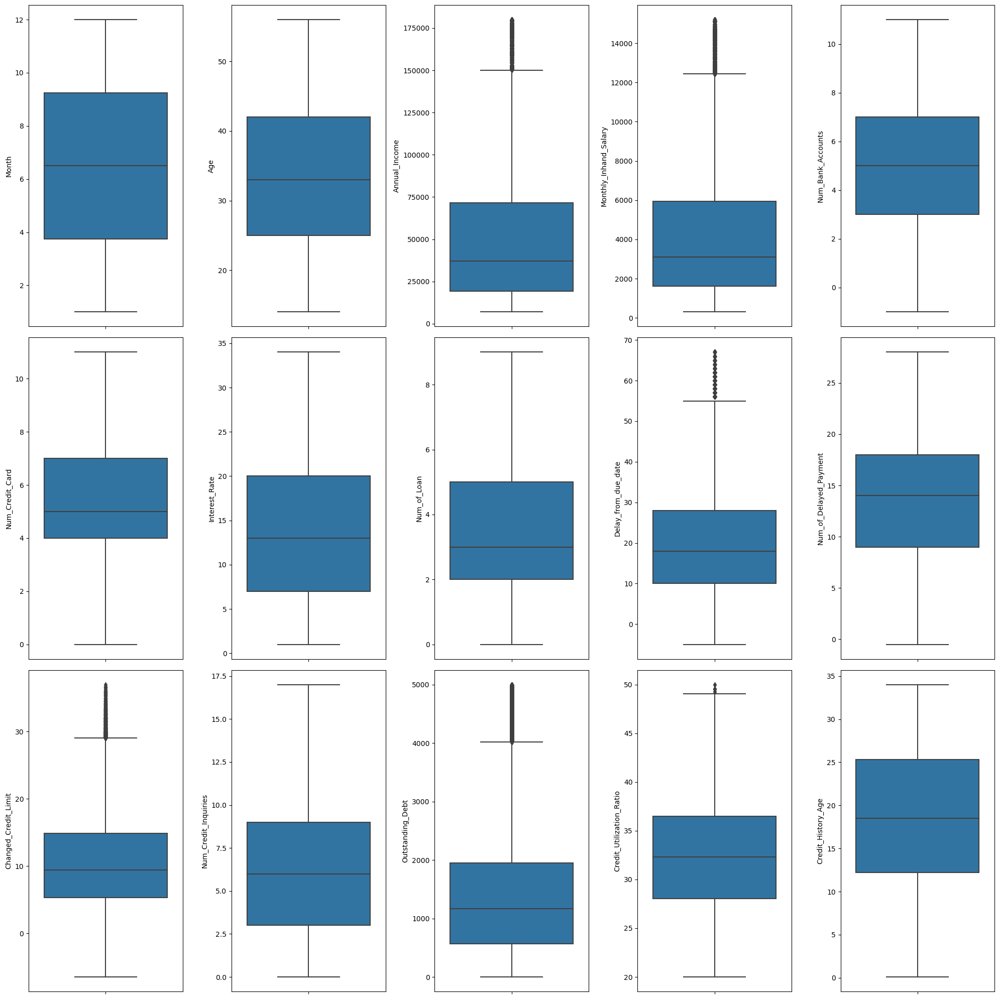

In [5]:
fig, ax= plt.subplots(3,5, figsize=(20,20))
for i,j in zip(range(len(final.select_dtypes(include='number').columns)), ax.flatten()):
    sns.boxplot(y=final.select_dtypes(include='number').iloc[:,i],ax=j,orient='v')
plt.tight_layout()
plt.show()

In [218]:
#all the possible wrong values have been cleared in the cleaning phase
#Annual income, monthly inhand salary, changed credit limit, outstanding debt, credit utilization ration
# the outliers seem to be naturally occuring and hence are not treated

### Univariate analysis - distribution

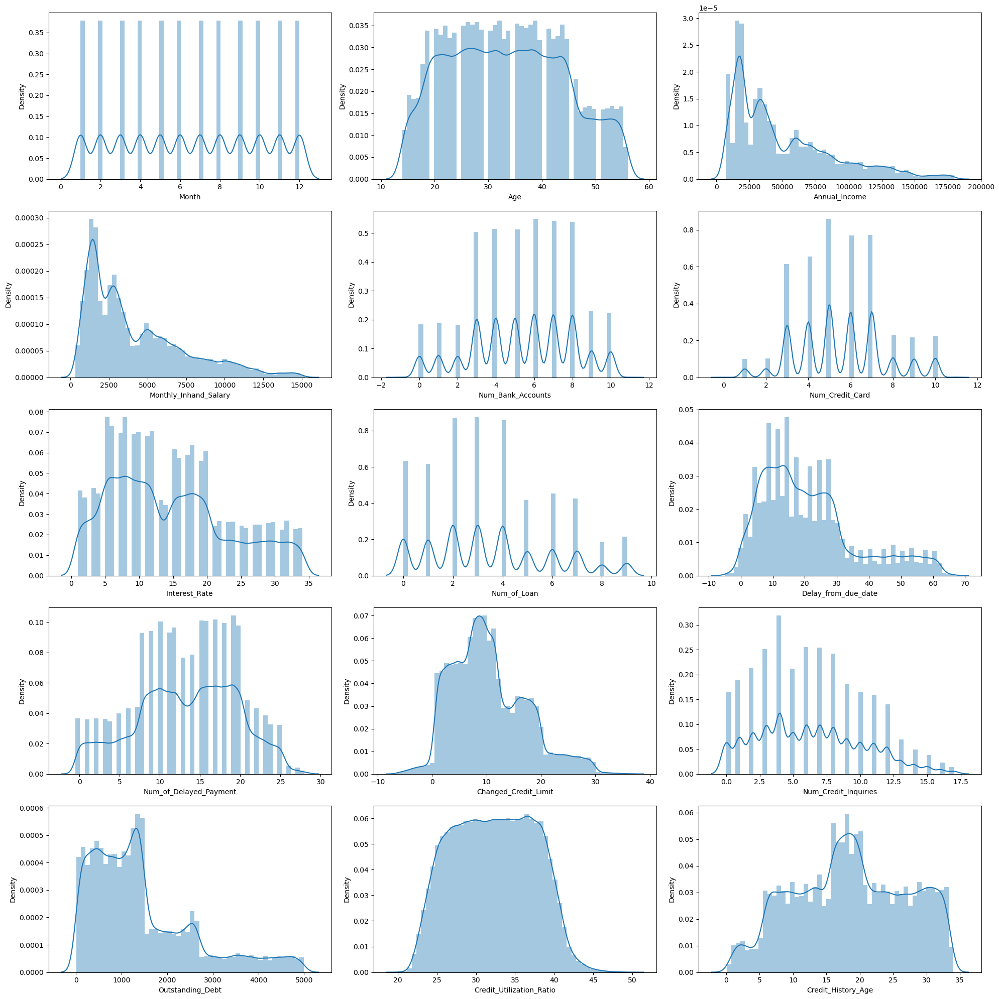

In [221]:
fig, ax= plt.subplots(3,5, figsize=(20,20))
for i,j in zip(range(len(final.select_dtypes(include='number').columns)), ax.flatten()):
    sns.distplot(final.select_dtypes(include='number').iloc[:,i],ax=j)
plt.tight_layout()
plt.show()

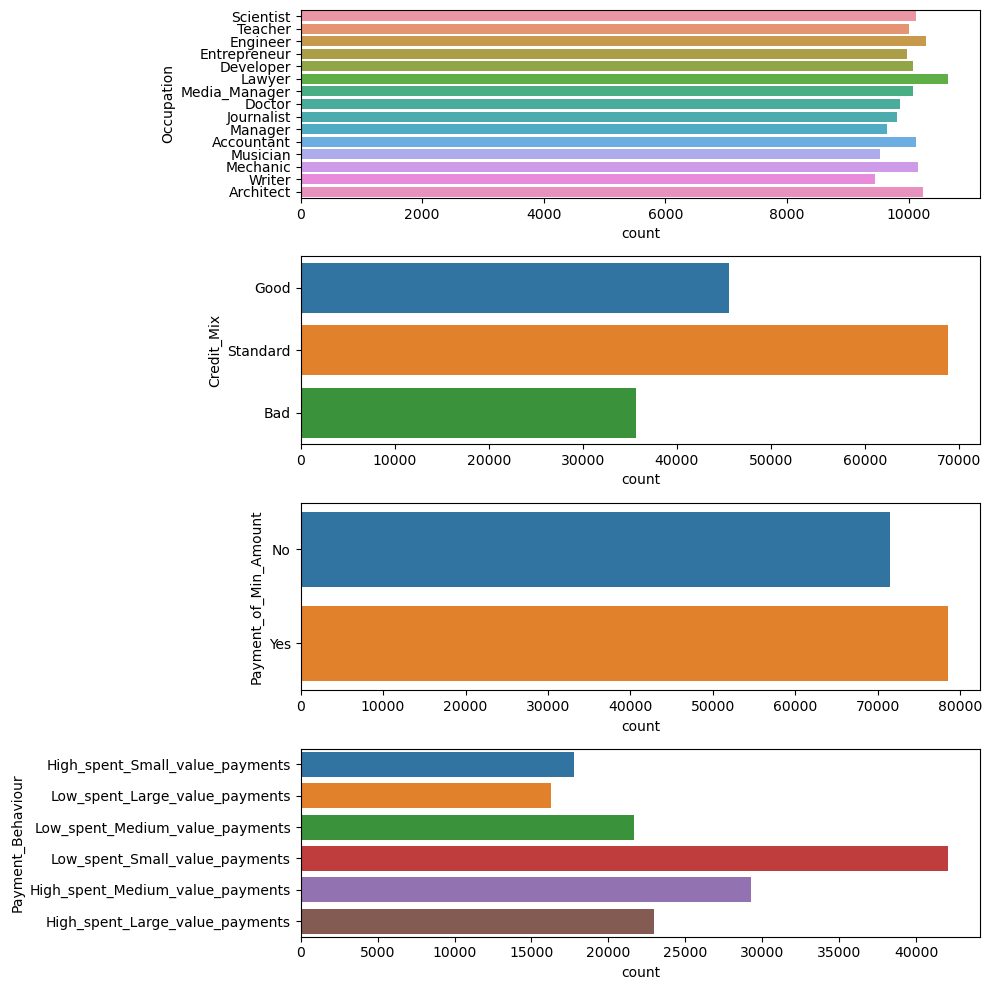

In [14]:
fig, ax= plt.subplots(4,1, figsize=(10,10))
for i,j in zip(range(len(final[['Occupation','Credit_Mix','Payment_of_Min_Amount','Payment_Behaviour','Credit_Score']].columns)), ax.flatten()):
    sns.countplot(y=final[['Occupation','Credit_Mix','Payment_of_Min_Amount','Payment_Behaviour','Credit_Score']].iloc[:,i],ax=j,orient='h')
plt.tight_layout()
plt.show()

### bivariate analysis

<AxesSubplot:>

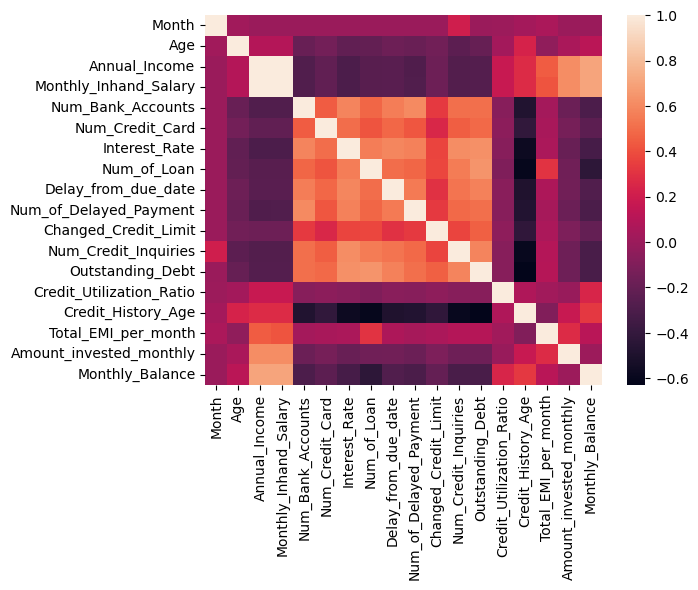

In [16]:
sns.heatmap(final.corr())

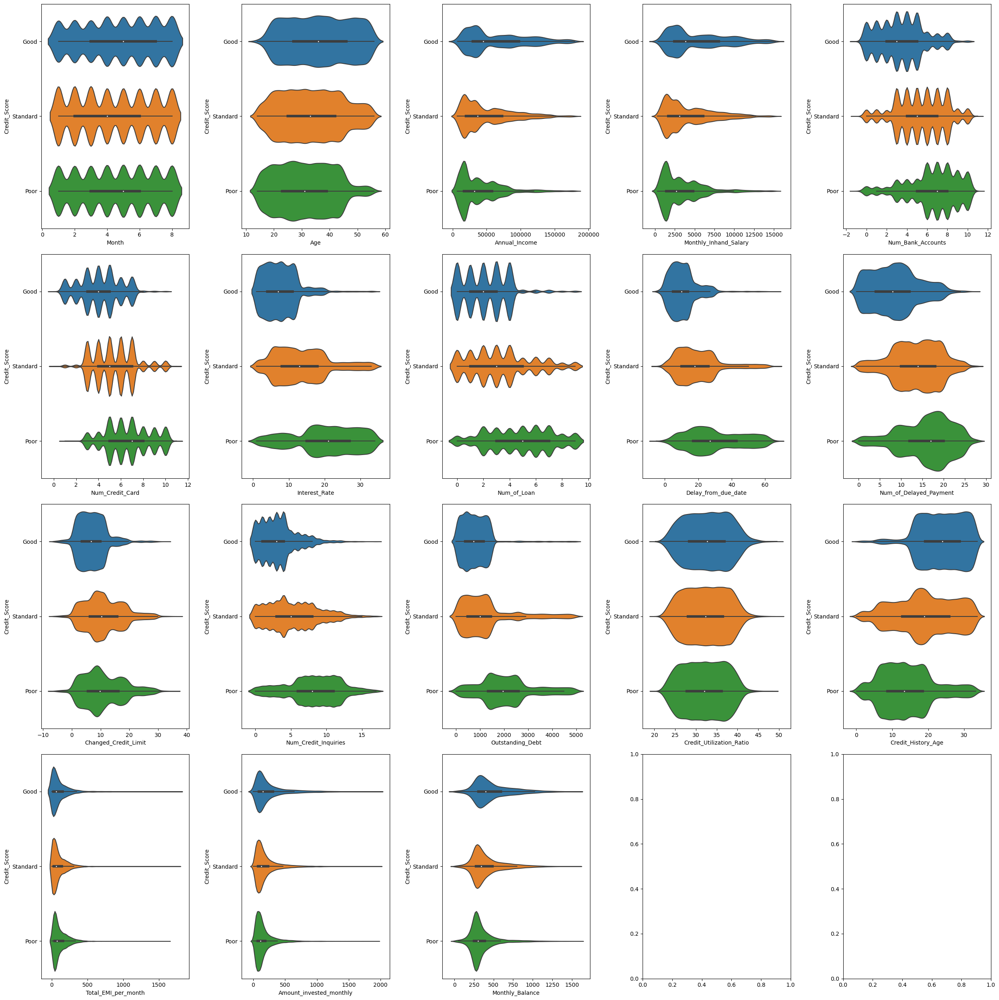

In [32]:
fig, ax= plt.subplots(4,5, figsize=(25,25))
for i,j in zip(range(len(final.select_dtypes(include='number').columns)), ax.flatten()):
    sns.violinplot(x=final.select_dtypes(include='number').iloc[:,i],y=final.Credit_Score,ax=j)
plt.tight_layout()
plt.show()

In [ ]:
#as months increased the number of good category has increased to some extent
#People aged more than 45 tend to have a better credit score                    --- good indicator to some extent
#people with very low annual income highly falls on poor credit score bracket   --- good indicator
#people with less bank accounts are falling more on good credit score bracket   --- very good indicator
#people with less credit cards are falling highly on good credit score bracket  --- very good indicator
#interest rate increases from good to bad credit score                          --- very good indicator
#people with higher number of loans have been categorized more in poor and standard brackets --- good indicator
#delayed payments are present mostly in poor credit score bracket               --- very good indicator
#number of delayed payments increases from good to bad credit score             --- very good indicator
#Higher credit limit changes are present only in standard and poor credit score bracket --- good indicator
#As the credit inquiries increases credit scores are being reduced (more in poor credit bracket) --- very good indicator
#Higher outstanding debts are present only in poor credit score bracket         --- good indicator
#Credit utilisation ratio does not seem to affect the credit score              --- bad indicator
#People with higher credit hitory range are falling in good credit score bracket --- very good indicator
#total emi per month, amount invested monthly and monthly balance does not have any discernable pattern with credit score - bad indicators

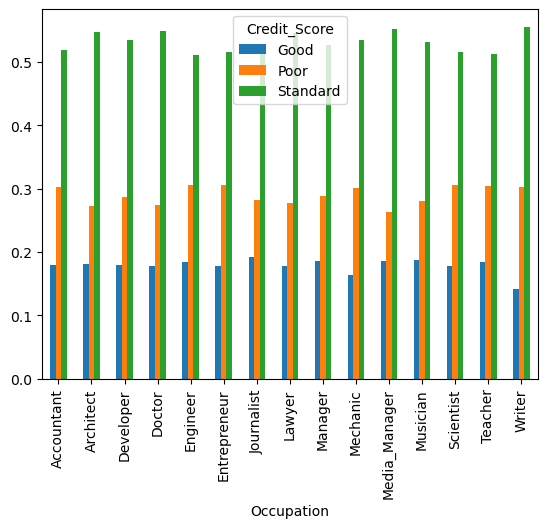

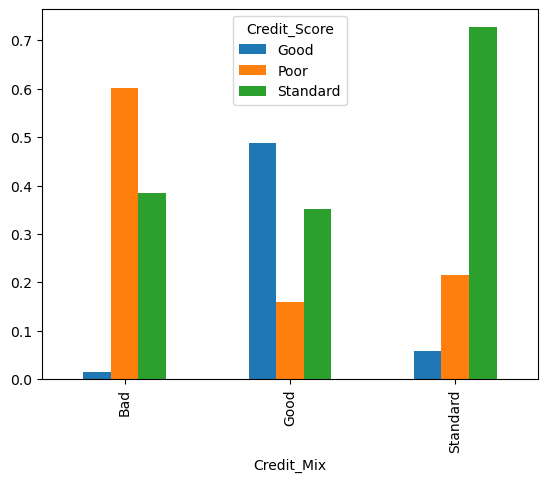

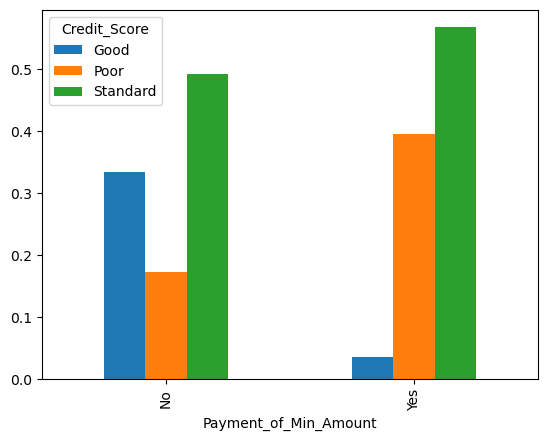

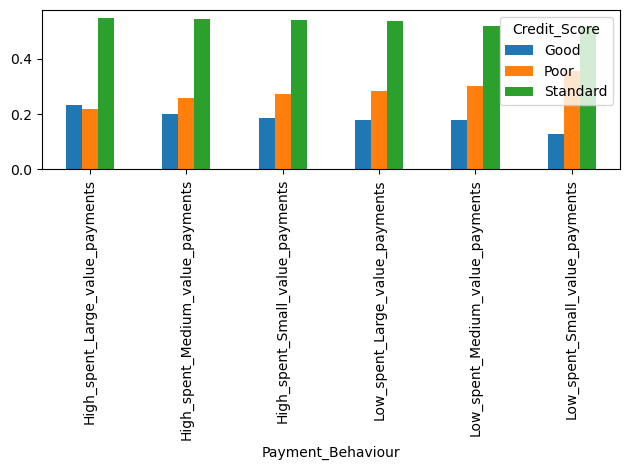

In [21]:
for i,j in zip(range(len(final[['Occupation','Credit_Mix','Payment_of_Min_Amount','Payment_Behaviour','Credit_Score']].columns)), ax.flatten()):
#     sns.countplot(x=final[['Occupation','Credit_Mix','Payment_of_Min_Amount','Payment_Behaviour','Credit_Score']].iloc[:,i],y=final.Credit_Score,ax=j,orient='h')
    pd.crosstab(final[['Occupation','Credit_Mix','Payment_of_Min_Amount','Payment_Behaviour','Credit_Score']].iloc[:,i], final.Credit_Score,normalize='index').plot(kind='bar')
plt.tight_layout()
plt.show()

In [ ]:
# occupation doesnt seem to affect the credit score  --- bad indicator
# people having good credit mix are highly under good credit score bracket and similary for other categories  --- very good indicator
# people who paid more than the minimum amount are highly falling under good credit bracket --- good indicator
# payment behaviour does not seem to affect the credit score --- bad indicator

### Multivariate analysis

<Figure size 3000x3000 with 0 Axes>

<Figure size 3000x3000 with 0 Axes>

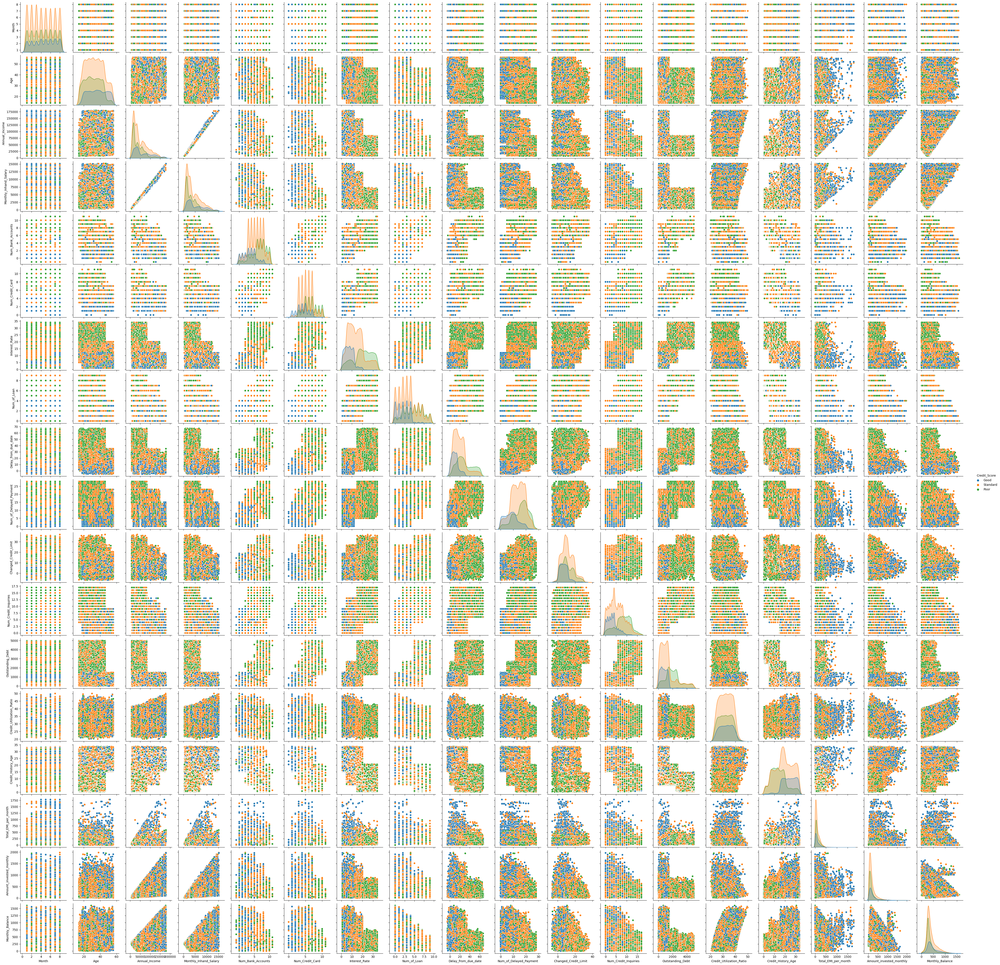

In [5]:
plt.figure(figsize=(30,30))
sns.pairplot(final,hue='Credit_Score')
plt.show()

In [ ]:
#Age
# aged people are mostly either in standard and good credit score bracket.
# interest rates are less than 25% for people aged more than 45 
# Maximum delay made by people of age greater than 45 is not more than 40 days however number of delayed payments are comparable to lower ages
# Outstanding debt is not more than 1500 for aged people

# Annual income
# Very less number of higher income group people are in bad credit score bracket
# higher number of bank accounts and credit cards are in possession of low to modearte income people
# interest rate decreases as the income increases
# outstanding debt and delay in due dates are low when the income is high

# number of bank accounts
# people with higher number of both bank accounts and credit cards are mostly in poor credit score bracket
# number of loans taken increases with bank account
# number of delayed payments, credit card limit change, outstranding debt, delay from due date are increasing as the number of bank account increases.

# number of credit cards
# people with less cards are making payments on time and are on good credit score bracket, opposite for the people with higher credit cards

# interest rate
# people making delayed payments and also interest rate is high they are in poor credit score category
# when credit enquires made are less and also interest rates are less, very few are in poor credit score category
# very few people who have higher interest rate and higher outstanding debt are in good credit score category

# delayed payment
# people who didnt delay payments much and have made very less credit enquiries are highly in standard and good credit score brackets.

#outstanding debt
# people with lower outstanding debt and high monthly investment amount fall mostly in good credit score bracket


### Statistical analysis

In [ ]:
import scipy.stats as stats
stat_df = final.iloc[:100000,:]
#test for normality

#h0=data is normally distributed
#h1=data is not normally distributed

AI_P= stat_df[stat_df['Credit_Score']=='Poor'].Annual_Income
AI_S= stat_df[stat_df['Credit_Score']=='Standard'].Annual_Income
AI_G= stat_df[stat_df['Credit_Score']=='Good'].Annual_Income
print(stats.shapiro(AI_P))
print(stats.shapiro(AI_S))
print(stats.shapiro(AI_G))
print(stats.shapiro(stat_df.Annual_Income))

#p value less than 0.5 rejecting null hypothesis

# non-parametric test

#h0 = annual income has no effect on credit score
#ha= annual income has effect on credit score

stats.kruskal(AI_P,AI_S,AI_G)
#P value is 0, therefore the annual income has effect on credit score

In [ ]:
ct = pd.crosstab(stat_df.Occupation,stat_df.Credit_Score)

#h0 - columns are independent
#ha - columns are not independent

chi_stat,p,df,e = stats.chi2_contingency(ct)
print(p)
#pvalue is less than 0.5, the columns occupation and credit score are not independent

In [ ]:
ct = pd.crosstab(stat_df.Payment_Behaviour,stat_df.Credit_Score)

#h0 - columns are independent
#ha - columns are not independent

chi_stat,p,df,e = stats.chi2_contingency(ct)
print(p)
#pvalue is less than 0.5, the columns payment behaviour and credit score are not independent

In [ ]:
#test for normality

#h0=data is normally distributed
#h1=data is not normally distributed
CUR_P= stat_df[stat_df['Credit_Score']=='Poor'].Credit_Utilization_Ratio
CUR_S= stat_df[stat_df['Credit_Score']=='Standard'].Credit_Utilization_Ratio
CUR_G= stat_df[stat_df['Credit_Score']=='Good'].Credit_Utilization_Ratio
print(stats.shapiro(CUR_P))
print(stats.shapiro(CUR_S))
print(stats.shapiro(CUR_G))
print(stats.shapiro(stat_df.Credit_Utilization_Ratio))

#p value less than 0.5 rejecting null hypothesis

# non-parametric test

#h0 = Credit_Utilization_Ratio has no effect on credit score
#ha= Credit_Utilization_Ratio has effect on credit score

stats.kruskal(CUR_P,CUR_S,CUR_G)
#P value < 0.5, therefore the Credit_Utilization_Ratio has effect on credit score

### Preprocessing for model building

In [3]:
#spliting the test data concatenated first

model_df = final.iloc[0:100000,:]

In [4]:
deployement_df = final.iloc[100000:,:]

In [5]:
model_df.to_csv('train_cleaned',index=False)
deployement_df.to_csv('test_cleaned',index=False)

In [6]:
model_df1= model_df.copy()

In [160]:
model_df1.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,1,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.0,1824.843333,3.0,...,Good,809.98,26.822620,22.10,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,0x1603,CUS_0xd40,2,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.0,1824.843333,3.0,...,Good,809.98,31.944960,22.15,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,0x1604,CUS_0xd40,3,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.0,1824.843333,3.0,...,Good,809.98,28.609352,22.20,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,0x1605,CUS_0xd40,4,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.0,1824.843333,3.0,...,Good,809.98,31.377862,22.30,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,0x1606,CUS_0xd40,5,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.0,1824.843333,3.0,...,Good,809.98,24.797347,22.40,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


### converting the target column to numerical

In [7]:
model_df1['Credit_Score'] = model_df1.Credit_Score.map({'Poor':0, 'Standard':1, 'Good':2})

### converting all other required categorical columns to numerical

In [8]:
model_df1.select_dtypes(include = 'object').columns

Index(['ID', 'Customer_ID', 'Name', 'SSN', 'Occupation', 'Type_of_Loan',
       'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour'],
      dtype='object')

In [9]:
#based on the analysis carried out in the eda and domain knowledge, we can take Payment_of_Min_amount and Credit_Mix for building the model

In [10]:
model_df1_cat = pd.get_dummies(model_df1[['Credit_Mix', 'Payment_of_Min_Amount']],drop_first=True)

### Scaling Numerical columns

In [11]:
from sklearn.preprocessing import StandardScaler
SS= StandardScaler()
scaled = SS.fit_transform(model_df1.select_dtypes(include='number').iloc[:,:-1])
model_df1_numeric = pd.DataFrame(scaled,columns=model_df1.select_dtypes(include='number').iloc[:,:-1].columns)

In [12]:
#concatenate dataset
model_df_final = pd.concat([model_df1_cat,model_df1_numeric,model_df1.Credit_Score],axis=1)

### Model Building

In [13]:
#libraries for machine learning model building

from sklearn.model_selection import train_test_split

In [14]:
model1_df = model_df_final.drop(columns=['Total_EMI_per_month', 'Amount_invested_monthly','Monthly_Balance', 'Credit_Utilization_Ratio'])

In [15]:
#train test split for model 1
model1_X = model1_df.iloc[:,:-1]
model1_Y = model1_df.iloc[:,-1]
m1_Xtrain,m1_Xtest,m1_ytrain,m1_ytest = train_test_split(model1_X,model1_Y,test_size=0.3,random_state=100) 

In [16]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import confusion_matrix

### Standard function to evaluate the model

In [17]:
def performance_report(model,X,y):
    
    prediction = model.predict(X)
    
    print('confusion matrix:')
    print('****************\n')

    cm =pd.DataFrame(confusion_matrix(y,prediction),columns=['pred 0','pred 1','pred 2'],index=['act 0','act 1','act 2'])
    print(cm)
    
    
    print('\nClassification Report:')
    print('**********************\n')
    print(classification_report(y,prediction))
    
    
    print('\nFPRs:')
    print('****')
    print('0:', round(((cm.iloc[1:,0].sum())/(cm.iloc[1,:]+cm.iloc[2,:]).sum()),2),end = "")
    print('      --- not poor, but classified as poor')
    print('1:', round(((cm.iloc[0,1]+cm.iloc[2,1])/(cm.iloc[0,:]+cm.iloc[2,:]).sum()),2),end = "")
    print('      --- not standard, but classified as standard')
    print('2:', round(((cm.iloc[:2,2].sum())/(cm.iloc[0,:]+cm.iloc[1,:]).sum()),2),end = "")
    print('      --- not good, but classified as good')

    
    print('\nCohen kappa score:')
    print('******************')
    print(cohen_kappa_score(y,prediction))
    


### building base models

In [121]:
#base KNN model

KNN = KNeighborsClassifier() #5 neighbors
KNN.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(KNN,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(KNN,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   18178    1950     120
act 1    3367   32138    1760
act 2     257    2048   10182

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.83      0.90      0.86     20248
           1       0.89      0.86      0.88     37265
           2       0.84      0.82      0.83     12487

    accuracy                           0.86     70000
   macro avg       0.86      0.86      0.86     70000
weighted avg       0.87      0.86      0.86     70000


FPRs:
****
0: 0.07      --- not poor, but classified as poor
1: 0.12      --- not standard, but classified as standard
2: 0.03      --- not good, but classified as good

Cohen kappa score:
******************
0.7753912252179038



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    6889    1720     141
act 1    2025   12744    1140
act 2   

In [123]:
#base decision tree model

from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier()
DT.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(DT,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(DT,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   20248       0       0
act 1       0   37265       0
act 2       0       0   12487

Classification Report:
**********************

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     20248
           1       1.00      1.00      1.00     37265
           2       1.00      1.00      1.00     12487

    accuracy                           1.00     70000
   macro avg       1.00      1.00      1.00     70000
weighted avg       1.00      1.00      1.00     70000


FPRs:
****
0: 0.0      --- not poor, but classified as poor
1: 0.0      --- not standard, but classified as standard
2: 0.0      --- not good, but classified as good

Cohen kappa score:
******************
1.0



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    6534    2047     169
act 1    1800   12792    1317
act 2     180    1327    3

In [125]:
#base random forest model

from sklearn.ensemble import RandomForestClassifier

RFC = RandomForestClassifier()
RFC.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(RFC,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(RFC,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   20248       0       0
act 1       1   37264       0
act 2       0       0   12487

Classification Report:
**********************

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     20248
           1       1.00      1.00      1.00     37265
           2       1.00      1.00      1.00     12487

    accuracy                           1.00     70000
   macro avg       1.00      1.00      1.00     70000
weighted avg       1.00      1.00      1.00     70000


FPRs:
****
0: 0.0      --- not poor, but classified as poor
1: 0.0      --- not standard, but classified as standard
2: 0.0      --- not good, but classified as good

Cohen kappa score:
******************
0.9999762343708145



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    7382    1335      33
act 1    1623   13281    1005
act 2      

In [ ]:
#in the base models KNN perform better than others
#the decision tree and random forest models are overfit and produce varying results on train and test dataset

### Same models with different parameters

In [126]:
#KNN model 2 with 7 neighbors and manhattan distance measurement

KNN = KNeighborsClassifier(n_neighbors=7,metric='manhattan') 
KNN.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(KNN,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(KNN,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   17987    2212      49
act 1    3804   31320    2141
act 2      51    2259   10177

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.82      0.89      0.85     20248
           1       0.88      0.84      0.86     37265
           2       0.82      0.82      0.82     12487

    accuracy                           0.85     70000
   macro avg       0.84      0.85      0.84     70000
weighted avg       0.85      0.85      0.85     70000


FPRs:
****
0: 0.08      --- not poor, but classified as poor
1: 0.14      --- not standard, but classified as standard
2: 0.04      --- not good, but classified as good

Cohen kappa score:
******************
0.7521118279404198



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    7179    1504      67
act 1    1960   12785    1164
act 2   

In [ ]:
#the knn has performed better on the test data set than the base model providing similar results in the train dataset

In [127]:
#KNN model 3 with 3 neighbors and manhattan distance measurement

KNN = KNeighborsClassifier(n_neighbors=3,metric='manhattan') 
KNN.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(KNN,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(KNN,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   19108    1135       5
act 1    2724   32861    1680
act 2      23     932   11532

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.87      0.94      0.91     20248
           1       0.94      0.88      0.91     37265
           2       0.87      0.92      0.90     12487

    accuracy                           0.91     70000
   macro avg       0.90      0.92      0.91     70000
weighted avg       0.91      0.91      0.91     70000


FPRs:
****
0: 0.06      --- not poor, but classified as poor
1: 0.06      --- not standard, but classified as standard
2: 0.03      --- not good, but classified as good

Cohen kappa score:
******************
0.8478926053090544



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    7370    1373       7
act 1    1933   12685    1291
act 2   

In [ ]:
#4 percent increase in accuracy of prediction in test data but the accuracy in the train data is 10% more than the test, inconsistent results

In [176]:
# model_df1_cat = pd.get_dummies(model_df1[['Credit_Mix', 'Payment_of_Min_Amount']],drop_first=True)
# X=pd.concat([model_df1.select_dtypes(include='number').drop(columns=['Credit_Utilization_Ratio','Monthly_Balance','Amount_invested_monthly','Total_EMI_per_month','Credit_Score']),model_df1_cat],axis=1)
# y = model_df1.iloc[:,-1]

In [178]:
# Xtrain,Xtest,ytrain,ytest = train_test_split(X,y,test_size=0.3,random_state=100)

In [182]:
#decision tree model 2

from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(criterion = 'gini',
                                  max_depth = 5,
                                  min_samples_split = 4,
                                  max_leaf_nodes = 6,
                                  random_state = 10)
DT.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(DT,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(DT,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   11248    6915    2085
act 1    4209   26372    6684
act 2    1035    2035    9417

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.68      0.56      0.61     20248
           1       0.75      0.71      0.73     37265
           2       0.52      0.75      0.61     12487

    accuracy                           0.67     70000
   macro avg       0.65      0.67      0.65     70000
weighted avg       0.69      0.67      0.67     70000


FPRs:
****
0: 0.11      --- not poor, but classified as poor
1: 0.27      --- not standard, but classified as standard
2: 0.15      --- not good, but classified as good

Cohen kappa score:
******************
0.46822170931156637



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    4902    3018     830
act 1    1816   11222    2871
act 2  

In [184]:
#decision tree model 3

from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(criterion = 'entropy',
                                  max_depth = 10,
                                  min_samples_split = 5,
                                  max_leaf_nodes = 8,
                                  random_state = 10)
DT.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(DT,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(DT,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   11106    7193    1949
act 1    4716   25966    6583
act 2    1232    1987    9268

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.65      0.55      0.60     20248
           1       0.74      0.70      0.72     37265
           2       0.52      0.74      0.61     12487

    accuracy                           0.66     70000
   macro avg       0.64      0.66      0.64     70000
weighted avg       0.67      0.66      0.66     70000


FPRs:
****
0: 0.12      --- not poor, but classified as poor
1: 0.28      --- not standard, but classified as standard
2: 0.15      --- not good, but classified as good

Cohen kappa score:
******************
0.4520804121335086



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    4827    3144     779
act 1    2025   11060    2824
act 2   

In [ ]:
#both the decision tree models perform worse than the KNN models

In [185]:
#Random forest model 1

from sklearn.ensemble import RandomForestClassifier

RFC = RandomForestClassifier(n_estimators=10,
                             criterion = 'entropy',
                             max_depth = 10,
                             min_samples_split = 5,
                             max_leaf_nodes = 8,
                             random_state = 10)
RFC.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(RFC,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(RFC,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   14468    3557    2223
act 1    7946   22852    6467
act 2     275    3400    8812

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.64      0.71      0.67     20248
           1       0.77      0.61      0.68     37265
           2       0.50      0.71      0.59     12487

    accuracy                           0.66     70000
   macro avg       0.64      0.68      0.65     70000
weighted avg       0.68      0.66      0.66     70000


FPRs:
****
0: 0.17      --- not poor, but classified as poor
1: 0.21      --- not standard, but classified as standard
2: 0.15      --- not good, but classified as good

Cohen kappa score:
******************
0.4629876335873907



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    6365    1481     904
act 1    3308    9816    2785
act 2   

In [186]:
#Random forest model 2

from sklearn.ensemble import RandomForestClassifier

RFC = RandomForestClassifier(n_estimators=30,
                             criterion = 'gini',
                             max_depth = 10,
                             min_samples_split = 4,
                             max_leaf_nodes = 6,
                             random_state = 10)
RFC.fit(m1_Xtrain,m1_ytrain)

print('prediction on training set')
performance_report(RFC,m1_Xtrain,m1_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(RFC,m1_Xtest,m1_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   14473    2328    3447
act 1    8053   21788    7424
act 2     298    1868   10321

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.63      0.71      0.67     20248
           1       0.84      0.58      0.69     37265
           2       0.49      0.83      0.61     12487

    accuracy                           0.67     70000
   macro avg       0.65      0.71      0.66     70000
weighted avg       0.72      0.67      0.67     70000


FPRs:
****
0: 0.17      --- not poor, but classified as poor
1: 0.13      --- not standard, but classified as standard
2: 0.19      --- not good, but classified as good

Cohen kappa score:
******************
0.48852106681773866



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    6359    1018    1373
act 1    3375    9328    3206
act 2  

In [ ]:
#accuracy is low for the random forest models as well, than the KNN

### Feature selection

In [192]:
#forward feature selection

from mlxtend.feature_selection import SequentialFeatureSelector as SFS
KNN_f = KNeighborsClassifier()
feature_selector = SFS(estimator = KNN_f,k_features='best',forward =True,verbose=2, scoring='accuracy')
foward_f = feature_selector.fit(m1_Xtrain,m1_ytrain)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   15.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  17 out of  17 | elapsed:  1.4min finished

[2023-09-03 18:25:22] Features: 1/17 -- score: 0.7538[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:   28.2s finished

[2023-09-03 18:25:50] Features: 2/17 -- score: 0.7698142857142857[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:   29.4s finished

[2023-09-03 18:26:20] Features: 3/17 -- score: 0.7740285714285714[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   

In [197]:
foward_f.k_feature_names_

('Credit_Mix_Good',
 'Credit_Mix_Standard',
 'Age',
 'Monthly_Inhand_Salary',
 'Num_Bank_Accounts',
 'Num_Credit_Card',
 'Interest_Rate',
 'Num_of_Loan',
 'Delay_from_due_date',
 'Num_of_Delayed_Payment',
 'Outstanding_Debt',
 'Credit_History_Age')

In [216]:
#forward feature selection for RFC

from mlxtend.feature_selection import SequentialFeatureSelector as SFS
RFC = RandomForestClassifier()
feature_selector = SFS(estimator = RFC,k_features=10,forward =True,verbose=2, scoring='accuracy')
RFC_f = feature_selector.fit(m1_Xtrain,m1_ytrain)
RFC_f.k_feature_names_

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  17 out of  17 | elapsed:  4.0min finished

[2023-09-03 20:41:03] Features: 1/10 -- score: 0.7894142857142856[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   40.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  8.1min finished

[2023-09-03 20:49:09] Features: 2/10 -- score: 0.7926142857142857[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   33.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:  7.3min finished

[2023-09-03 20:56:28] Features: 3/10 -- score: 0.7981285714285715[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  

('Credit_Mix_Good',
 'Month',
 'Age',
 'Monthly_Inhand_Salary',
 'Num_Bank_Accounts',
 'Num_Credit_Card',
 'Interest_Rate',
 'Num_of_Loan',
 'Outstanding_Debt',
 'Credit_History_Age')

In [29]:
#features from forward selection
ff = ['Credit_Mix_Good','Credit_Mix_Standard','Age','Monthly_Inhand_Salary','Num_Bank_Accounts','Num_Credit_Card','Interest_Rate','Num_of_Loan','Delay_from_due_date','Num_of_Delayed_Payment','Outstanding_Debt','Credit_History_Age']

In [30]:
model2_ff = model1_X[ff]
model2_y = model1_Y
m2_Xtrain,m2_Xtest,m2_ytrain,m2_ytest = train_test_split(model2_ff,model2_y,test_size=0.3,random_state=100) 

In [203]:
#KNN model with the obtained features

KNN = KNeighborsClassifier(n_neighbors=7,metric='manhattan') 
KNN.fit(m2_Xtrain,m2_ytrain)

print('prediction on training set')
performance_report(KNN,m2_Xtrain,m2_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(KNN,m2_Xtest,m2_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   17830    2382      36
act 1    3963   30971    2331
act 2      71    2284   10132

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.82      0.88      0.85     20248
           1       0.87      0.83      0.85     37265
           2       0.81      0.81      0.81     12487

    accuracy                           0.84     70000
   macro avg       0.83      0.84      0.84     70000
weighted avg       0.84      0.84      0.84     70000


FPRs:
****
0: 0.08      --- not poor, but classified as poor
1: 0.14      --- not standard, but classified as standard
2: 0.04      --- not good, but classified as good

Cohen kappa score:
******************
0.7394432201391391



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    7111    1580      59
act 1    2065   12625    1219
act 2   

In [230]:
RF_f=['Credit_Mix_Good','Month','Age','Monthly_Inhand_Salary','Num_Bank_Accounts','Num_Credit_Card','Interest_Rate','Num_of_Loan','Outstanding_Debt','Credit_History_Age']
model2_RF_X = model1_X[RF_f]
model2_RF_Y = model1_Y
m3_Xtrain,m3_Xtest,m3_ytrain,m3_ytest = train_test_split(model2_RF_X,model2_RF_Y,test_size=0.3,random_state=100)

In [231]:
#Random forest model 2

from sklearn.ensemble import RandomForestClassifier

RFC = RandomForestClassifier(n_estimators=30,
                             criterion = 'gini',
                             max_depth = 10,
                             min_samples_split = 4,
                             max_leaf_nodes = 6,
                             random_state = 10)
RFC.fit(m3_Xtrain,m3_ytrain)

print('prediction on training set')
performance_report(RFC,m3_Xtrain,m3_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(RFC,m3_Xtest,m3_ytest)
#not performing well even after feature selection

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   14354    2702    3192
act 1    8112   22092    7061
act 2     287    2699    9501

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.63      0.71      0.67     20248
           1       0.80      0.59      0.68     37265
           2       0.48      0.76      0.59     12487

    accuracy                           0.66     70000
   macro avg       0.64      0.69      0.65     70000
weighted avg       0.70      0.66      0.66     70000


FPRs:
****
0: 0.17      --- not poor, but classified as poor
1: 0.16      --- not standard, but classified as standard
2: 0.18      --- not good, but classified as good

Cohen kappa score:
******************
0.4685430644252345



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    6338    1136    1276
act 1    3388    9459    3062
act 2   

### Grid search cv

In [24]:
from sklearn.model_selection import GridSearchCV

In [209]:
KNN_G = KNeighborsClassifier()
parameters = {'n_neighbors': np.arange(1, 25, 2),'metric': ['hamming','euclidean','manhattan','Chebyshev']}

grid = GridSearchCV(estimator = KNN_G, param_grid=parameters, scoring = 'accuracy')
grid.fit(m2_Xtrain,m2_ytrain)
print(grid.best_params_)

{'metric': 'euclidean', 'n_neighbors': 3}


In [213]:
KNN_G = KNeighborsClassifier()
parameters = {'n_neighbors': np.arange(1, 11),'metric': ['hamming','euclidean','manhattan','Chebyshev']}

grid = GridSearchCV(estimator = KNN_G, param_grid=parameters,cv=3, scoring = 'accuracy')
grid.fit(m2_Xtrain,m2_ytrain)
print(grid.best_params_)

{'metric': 'euclidean', 'n_neighbors': 3}


In [ ]:
#best params given by grid search cv
#{'metric': 'euclidean', 'n_neighbors': 3}

In [34]:
#KNN model with the obtained features

KNN_final = KNeighborsClassifier(n_neighbors=3,metric='euclidean') 
KNN_final.fit(m2_Xtrain,m2_ytrain)

print('prediction on training set')
performance_report(KNN_final,m2_Xtrain,m2_ytrain)

print('\n\n')

print('prediction on test set')
performance_report(KNN_final,m2_Xtest,m2_ytest)

prediction on training set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0   18685    1563       0
act 1    3008   32376    1881
act 2      10    1349   11128

Classification Report:
**********************

              precision    recall  f1-score   support

           0       0.86      0.92      0.89     20248
           1       0.92      0.87      0.89     37265
           2       0.86      0.89      0.87     12487

    accuracy                           0.89     70000
   macro avg       0.88      0.89      0.89     70000
weighted avg       0.89      0.89      0.89     70000


FPRs:
****
0: 0.06      --- not poor, but classified as poor
1: 0.09      --- not standard, but classified as standard
2: 0.03      --- not good, but classified as good

Cohen kappa score:
******************
0.8167112314058557



prediction on test set
confusion matrix:
****************

       pred 0  pred 1  pred 2
act 0    7210    1537       3
act 1    2048   12442    1419
act 2   

In [ ]:
### cross validation
from sklearn.model_selection import cross_val_score
model = KNeighborsClassifier(n_neighbors=3, metric='euclidean')
Scores=cross_val_score(estimator= model, X=m2_Xtrain, y =m2_ytrain, cv=5, scoring = 'accuracy')
Scores
#array([0.78585714, 0.78821429, 0.788,0.78157143, 0.78892857])

In [49]:
#final model

model_df2=pd.read_csv('test_cleaned')
model_df2_cat = pd.get_dummies(model_df2[['Credit_Mix', 'Payment_of_Min_Amount']],drop_first=True)
from sklearn.preprocessing import StandardScaler
SS= StandardScaler()
scaled = SS.fit_transform(model_df2.select_dtypes(include='number').iloc[:,:-1])
model_df2_numeric = pd.DataFrame(scaled,columns=model_df2.select_dtypes(include='number').iloc[:,:-1].columns)
final_model_df = pd.concat([model_df2_cat,model_df2_numeric],axis=1)

final_test = final_model_df[ff]

In [54]:
### prediction and output
prediction = KNN_final.predict(final_test)

output = pd.DataFrame({'customerid':model_df2.Customer_ID,'prediction':prediction})
output.to_csv('output_dataset',index=False)

In [55]:
output

,customerid,prediction
0,CUS_0xd40,2
1,CUS_0xd40,2
2,CUS_0xd40,2
3,CUS_0xd40,2
4,CUS_0x21b1,2
...,...,...
49995,CUS_0x8600,1
49996,CUS_0x942c,0
49997,CUS_0x942c,0
49998,CUS_0x942c,1


### Conclusion

This initial-level machine learning model for classifying credit score brackets represents a promising step towards enhancing credit assessment processes. While this preliminary model may have its limitations, it lays the foundation for future refinements and improvements. Moving forward, it is aimed to do further research and algorithm optimization to enable building a more accurate and robust credit scoring classification system, contributing to fairer financial assessments and greater access to credit opportunities for a broader spectrum of individuals